In [81]:
# Numerical analysis
import numpy as np
import jax.numpy as jnp
from jax import random
from jax.nn import sigmoid

# Bayesian inference
import numpyro
import numpyro.distributions as dist
from numpyro.infer import MCMC, NUTS
import arviz as az

# Visualisation
import matplotlib.pyplot as plt
import seaborn as sns

# Set pseudo random number key
prng_key = random.PRNGKey(1)

In [82]:
# Parameters
n_realizations = 2
n = 400 # number of observations, length of beta_star 
D = n 
p_star = 20 # number of non-zero predictors
sigma = 1 # noise parameter

<h1> Generating Data </h1>

$$y_i \sim \beta_i + \epsilon_i$$
$$\epsilon_i \sim N(0, \sigma^2), \;\; i = 1, ..., 400$$
Similarly to Piironen's toy example, We generate $100$ data realizations. Our true parameter vector $\beta^*$ has length $D=400$ and $p^*=20$ non-zero entries with some value $A \in$ $\{1, 2, ..., 10\}$. The total number of observations per realization is $n=400$.

In [83]:
def generate_data(dim, pstar, A, sigma, nrep):
  """
  Generate synthetic data.

  Parameters:
    int dim: The dimension of the dataset
    int pstar: The number of true non-zero signals
    real A: The magnitude of true non-zero signals
    real sigma: Standard deviation of the noise
    nrep: The number of replications
  """
  data = np.zeros((nrep, dim))       # Initialise
  data[:, :pstar] += A               # Add signal
  data += np.random.normal(0, sigma, size=(nrep, dim))  # Add noise
  return data

<h2> Defining the Model </h2>

$$\begin{align*} 
\gamma_i &= \sigma ((L_i + \log(\alpha_i)) / \lambda) \text{  for   } i = 1, ..., n \\
L_i &= \log (U_i) - \log (1-U_i)\\
U_i &\sim \text{Uniform}(0, 1)
\end{align*}$$




In addition, the shrinkage coefficient $\kappa_i = 1 - \gamma_i$ is recorded.

In [84]:
def model(alphas, lam):
    '''
    Defines the Concrete random variable distribution with REBAR adjustment

    Parameters:
       real lam: temperature coefficient
       array alphas: parameter
    '''
    D = alphas.shape
    U = numpyro.sample("U", dist.Uniform(0, 1).expand(D))
    L = numpyro.deterministic("L", jnp.log(U) - jnp.log(1-U))
    T = numpyro.deterministic("T", jnp.log(alphas) - jnp.log(1-alphas))
    z_lam = numpyro.deterministic("z_lam", ((lam**2+lam+1)/(lam+1)) * T + L)

    gammas = numpyro.deterministic("gammas", sigmoid(z_lam/lam))
    kappas = numpyro.deterministic("kappas", 1-gammas)

In [85]:
def run_mcmc(model, prng_key, **kwargs):
    '''
    Run MCMC using the given model.

    Parameters:
       model: probabilistic model
       prng_key: random key 
       array y: observed data

    '''
    nuts = NUTS(model)
    mcmc = MCMC(nuts, num_warmup=500, num_samples=1000, progress_bar=False)
    mcmc.run(prng_key, **kwargs)
    return mcmc

In [86]:
def concrete(all_data, dim, pstar, lam):
    all_mse_values_d = dict()
    mean_mse_values_d = dict()
    all_kappas_d = dict()
    mean_betas_d = dict()
    mean_gammas_d = dict()
    all_mcmc_runs = []

    
    
    for a in ['constant', 'sigmoid']:
        beta_samples = {}
        kappa_samples = []
        mean_sq_errors = [0]*11
        for A, y in all_data.items():
            
            alpha_d = {'constant': jnp.full(shape=y.shape, fill_value=0.5), 
                       'sigmoid': sigmoid(y)}

            print(alpha_d[a])

            beta_star = np.zeros(dim) 
            beta_star[:pstar] += A

            mcmc = run_mcmc(model, prng_key, alphas = alpha_d[a], lam = lam)
            all_mcmc_runs.append(mcmc)

            samples = mcmc.get_samples()
            print(samples['z_lam'])

            mean_gammas = samples['gammas'].mean(axis=0) # mean across all samples in one mcmc run
            mean_gammas = mean_gammas.mean(axis=0) # mean across all repetitions

            estimated_betas = mean_gammas * beta_star
            beta_samples[A] = estimated_betas 

            mean_sq_errors[A] = jnp.mean((estimated_betas - beta_star)**2)
            
            kappa_samples.extend(samples['kappas'])

        all_mse_values_d[a] = []
        all_mse_values_d[a].append(mean_sq_errors)
        all_mse_values_d[a] = np.array(all_mse_values_d[a])
        mean_mse_values_d[a] = np.mean(all_mse_values_d[a], axis=0)

        all_kappas_d[a] = []
        all_kappas_d[a].extend(kappa_samples)

        mean_gammas_d[a] = mean_gammas

        mean_betas_d[a] = beta_samples

        all_mcmc_runs.append(mcmc) 

    return mean_mse_values_d, all_kappas_d, mean_betas_d, mean_gammas_d, all_mcmc_runs, samples

<h1> Run and Evaluate MCMC </h1>

In [87]:

all_data = {}
A_values = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
smaller_A_values = [4, 6]
for A in A_values:
    all_data[A] = generate_data(dim=D, pstar=p_star, A=A, sigma=1, nrep=n_realizations) 

lam = 1/2
mean_sq_errors, kappas, beta_samples, gamma_samples, mcmc_runs, samples = concrete(all_data, dim=D, pstar=p_star, lam=lam)



[[0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
  0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 

The <a href=https://mc-stan.org/docs/2_21/reference-manual/effective-sample-size-section.html>estimated effective sample size (ESS)</a> measures how much information is lost in MCMC due to correlation between different samples.

The <a href=https://arxiv.org/abs/1812.09384>Gelman-Rubin statistic</a> ($\hat{R}$) examines how well the chains have mixed. Common thresholds used include $1.01$, $1.05$, and $1.1$.

In [88]:
# for mcmc in mcmc_runs[::20]:
#     mcmc.print_summary()

<h1> Results </h1>

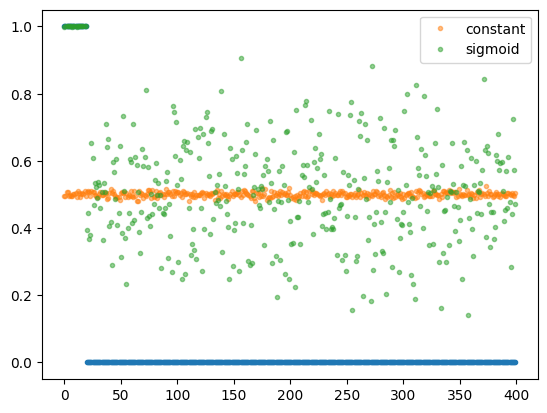

In [89]:
# fig, ax = plt.subplots(1, 2, figsize=(12, 5), layout="tight")

true_gamma = np.zeros(n)
true_gamma[:p_star] = 1

plt.plot(range(D), true_gamma, '.')
for a in ['constant', 'sigmoid']:
    plt.plot(range(D), gamma_samples[a], '.', label=a, alpha=0.5)


plt.legend()

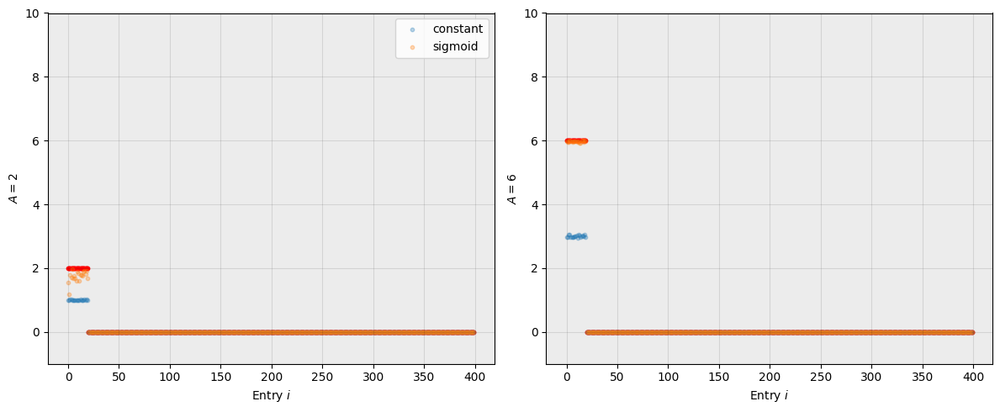

In [90]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5), layout="tight")
for ax in [ax1, ax2]: 
    ax.set_facecolor("#ECECEC") # set graph background color to grey
    ax.grid(visible=True, color="black", alpha=0.1) # add grid lines

# resetting y-axis range so that the graphs line up
ax2.set_ylim([-1, 10]) 
ax1.set_ylim([-1, 10])

beta_star_6 = np.zeros(n)
beta_star_6[:p_star] = 6
beta_star_2 = np.zeros(n)
beta_star_2[:p_star] = 2

ax1.scatter(range(D), beta_star_2, color='red', s=10) # plot actual betas
ax2.scatter(range(D), beta_star_6, color='red', s=10) 

for a in ['constant', 'sigmoid']:
    ax1.scatter(range(D), beta_samples[a][2], s=10, alpha=0.3, label=a)
    ax2.scatter(range(D), beta_samples[a][6], s=10, alpha=0.3, label=a)


# add labels to graph
ax1.set(ylabel=r'$A=2$', xlabel=r'Entry $i$')
ax2.set(ylabel=r'$A=6$', xlabel=r'Entry $i$')
ax1.legend()


As $\lambda$ decreases, mean squared error decreases.

Text(0.5, 1.0, 'Mean Squared Error for Different Alpha Values')

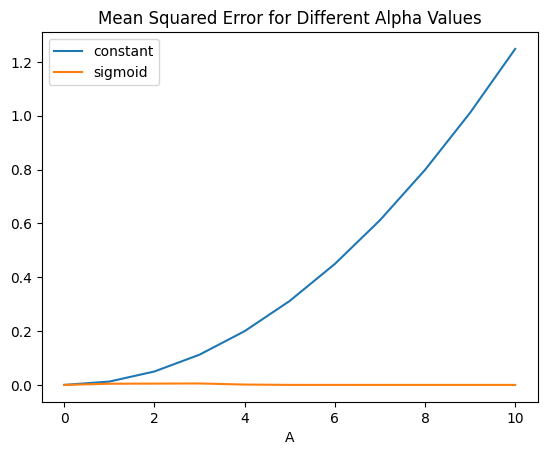

In [91]:
for a in ['constant', 'sigmoid']:
    plt.plot(range(len(mean_sq_errors[a])), mean_sq_errors[a], label=a)
ax = plt.gca()
plt.legend()
plt.xlabel("A")
plt.title("Mean Squared Error for Different Alpha Values")

As the value of $\lambda$ decreases, the distribution of $\kappa$ values becomes more concentrated around $0$ and $1$.

In [92]:
kappas

{'constant': [Array([[7.66268373e-02, 3.08160841e-01, 9.62328076e-01, 5.28292179e-01,
          9.12461281e-01, 1.77163839e-01, 2.82519341e-01, 9.90674734e-01,
          9.70054567e-01, 9.31179404e-01, 5.55500865e-01, 1.84484124e-02,
          9.83933270e-01, 1.00198388e-02, 9.03799951e-01, 9.35103238e-01,
          6.87468648e-02, 6.13277793e-01, 4.78506744e-01, 1.32130384e-02,
          5.26917100e-01, 2.87886918e-01, 6.37794256e-01, 1.40929282e-01,
          4.24819589e-02, 9.69202101e-01, 8.76885712e-01, 2.93514132e-02,
          5.60675263e-02, 1.45909846e-01, 3.94566059e-02, 8.51891696e-01,
          8.90965044e-01, 5.73572874e-01, 1.94576502e-01, 3.78143787e-01,
          9.45623934e-01, 1.95537448e-01, 9.30608749e-01, 4.36500847e-01,
          9.93425012e-01, 1.94053590e-01, 2.92420685e-01, 4.70399857e-04,
          2.70766020e-03, 8.78176332e-01, 4.20942962e-01, 6.65921628e-01,
          6.87043548e-01, 9.76421595e-01, 3.97038460e-03, 5.82985282e-02,
          4.15481448e-01, 

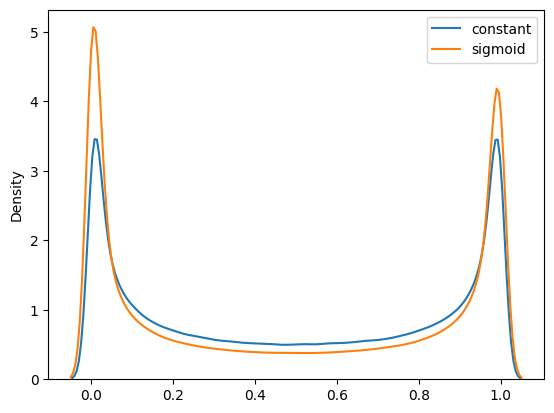

In [93]:
for a in ['constant', 'sigmoid']:
    kappas[a] = np.ndarray.flatten(np.array(kappas[a]))
    sns.kdeplot(kappas[a], label=a)
plt.legend()
